<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

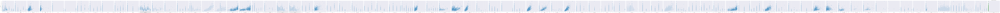

the category is MSSubClass and number of features are 15
the category is MSZoning and number of features are 5
the category is LotFrontage and number of features are 109
the category is LotArea and number of features are 1069
the category is Street and number of features are 2
the category is Alley and number of features are 2
the category is LotShape and number of features are 4
the category is LandContour and number of features are 4
the category is Utilities and number of features are 2
the category is LotConfig and number of features are 5
the category is LandSlope and number of features are 3
the category is Neighborhood and number of features are 25
the category is Condition1 and number of features are 9
the category is Condition2 and number of features are 8
the category is BldgType and number of features are 5
the category is HouseStyle and number of features are 8
the category is OverallQual and number of features are 10
the category is OverallCond and number of features are 9

,FireplaceQu,BsmtQual,BsmtCond,GarageQual,GarageCond,ExterQual,ExterCond,HeatingQC,PoolQC,KitchenQual,...,GarageFinish,LandSlope,LotShape,PavedDrive,Street,Alley,MSSubClass,OverallCond,OverallQual,MoSold
0,0,4,3,3,3,4,3,5,0,4,...,2,3,4,2,2,0,6,5,7,2
1,3,4,3,3,3,3,3,5,0,3,...,2,3,4,2,2,0,1,8,6,5
2,3,4,3,3,3,4,3,5,0,4,...,2,3,3,2,2,0,6,5,7,9
3,4,3,4,3,3,3,3,4,0,4,...,1,3,3,2,2,0,7,5,7,2
4,3,4,3,3,3,4,3,5,0,4,...,2,3,3,2,2,0,6,5,8,12
5,0,4,3,3,3,3,3,5,0,3,...,1,3,3,2,2,0,5,5,5,10
6,4,5,3,3,3,4,3,5,0,4,...,2,3,4,2,2,0,1,5,8,8
7,3,4,3,3,3,3,3,5,0,3,...,2,3,3,2,2,0,6,6,7,11
8,3,3,3,2,3,3,3,4,0,3,...,1,3,4,2,2,0,5,5,7,4
9,3,3,3,4,3,3,3,5,0,3,...,2,3,4,2,2,0,15,6,5,1


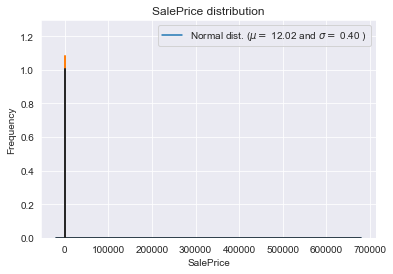

In [1]:
#import some necessary librairies

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
%matplotlib inline
import matplotlib.pyplot as plt  # Matlab-style plotting
import seaborn as sns
color = sns.color_palette()
sns.set_style('darkgrid')
import warnings
def ignore_warn(*args, **kwargs):
    pass
warnings.warn = ignore_warn #ignore annoying warning (from sklearn and seaborn)


from scipy import stats
from scipy.stats import norm, skew #for some statistics

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

# importing data
data=pd.read_csv('train.csv')

data.head(5)

# displaying common data metrics
data.info()

#### Check for duplicates
idsUnique = len(set(data.Id))
idsTotal = data.shape[0]
idsDupli = idsTotal - idsUnique
print("There are " + str(idsDupli) + " duplicate IDs for " + str(idsTotal) + " total entries")

#### Drop Id column
data.drop("Id", axis = 1, inplace = True)

cols=data.columns

sns.pairplot(data,x_vars=cols,y_vars='SalePrice',height=5)

####  The author of the dataset recommends removing 'any houses with more than 4000 square feet' from the dataset.
#Reference : https://ww2.amstat.org/publications/jse/v19n3/decock.pdf

# GrLivArea: Above grade (ground) living area square feet
# plotting scatter plot
plt.scatter(data.GrLivArea, data.SalePrice, c = "green", marker = "o")
plt.title("SquareArea vs SalePrice")
plt.xlabel("GrLivArea")
plt.ylabel("SalePrice")
plt.show()



# removing all the rows with area>4000
data=data[data.GrLivArea<4000]

data.shape  # checking data size

# we will now check SalePrice for its closeness to the normal distribution. 
sns.distplot(data['SalePrice'],fit=norm);
(mu, sigma)=norm.fit(data['SalePrice'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')
plt.ylabel('Frequency')
plt.title('SalePrice distribution')

# We need to transform the target variable as linear models favor normlised data

# transforming Sales Price by log (1+x) transformation. This caters for 0 values in the columns
data['SalePrice']=np.log1p(data['SalePrice'])
# we check the distribution again after the transformation
sns.distplot(data['SalePrice'],fit=norm);
(mu, sigma)=norm.fit(data['SalePrice'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')
plt.ylabel('Frequency')
plt.title('SalePrice distribution')

#### Our target variable is normally distributed

# we will see each column for the type of data present
for i in data.columns:
    print("the category is {} and number of features are {}".format(i,data[i].nunique()))

categorical=[feat for feat in data.columns if data[feat].nunique()<30]

for i in categorical:
    print("the category is {} and number of features are {}".format(i,data[i].unique()))

#### Checking for missing values

data_na=(data.isna().sum()/len(data))*100 # creating a series that has total percentage of missing values

data_na=data_na.drop(data_na[data_na==0].index).sort_values(ascending=False) # filtering the series and sorting

data_na=pd.DataFrame({'Missing':data_na}) # creating dataframe and storing
data_na.head(30)

### Handling missing values

#### PoolQC:  categorical ordinal

#PoolQC : data description says NA means "No Pool".Majority of houses have no Pool at all in general. 

data['PoolQC']=data['PoolQC'].fillna('None')

#### miscellaneous: categorical nominal

# miscellaneous features: Na means None
data["MiscFeature"] = data["MiscFeature"].fillna("None")


#### alley: categorical nominal

#Alley :NA means "no alley access"
data["Alley"] = data["Alley"].fillna("None")

#### fence: categorical nominal

#NA means "no fence"
data["Fence"] = data["Fence"].fillna("None")

#### FireplaceQu: categorical ordinal

#FireplaceQu :NA means "no fireplace"
data["FireplaceQu"] = data["FireplaceQu"].fillna("None")


#### LotFrontage: numerical continuous

#fill in missing values by the median LotFrontage (the street area) of the neighborhood.
data['LotFrontage']=data.groupby('Neighborhood')['LotFrontage'].transform(lambda x: x.fillna(x.median()))

#### GarageFinish, GarageQual and GarageCond: categorical ordinal    GarageType: categorical nominal

#GarageType, GarageFinish, GarageQual and GarageCond : Replacing missing data with None
for col in ('GarageType', 'GarageFinish', 'GarageQual', 'GarageCond'):
    data[col] = data[col].fillna('None')

#### GarageYrBlt, GarageArea and GarageCars are all numerical

#GarageYrBlt, GarageArea and GarageCars : Replacing Nan with 0 No garage = no cars in such garage
for col in ('GarageYrBlt', 'GarageArea', 'GarageCars'):
    data[col] = data[col].fillna(0)

#### basement areas: numerical continuous  , fullbath, half bath: numerical discrete

#BsmtFinSF1, BsmtFinSF2, BsmtUnfSF, TotalBsmtSF, BsmtFullBath and BsmtHalfBath : missing values are likely zero for having no basement
for col in ('BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF','TotalBsmtSF', 'BsmtFullBath', 'BsmtHalfBath'):
    data[col] = data[col].fillna(0)

#### these are all categorical ordinal

#BsmtQual, BsmtCond, BsmtExposure, BsmtFinType1 and BsmtFinType2 :NaN means that there is no basement.
for col in ('BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2'):
    data[col] = data[col].fillna('No')

#### masonry area is numeric continuous, type is categorical nominal

#MasVnrArea and MasVnrType : We can fill 0 for the area and None for the type.
data["MasVnrType"] = data["MasVnrType"].fillna("None")
data["MasVnrArea"] = data["MasVnrArea"].fillna(0)

#### mszoning is categorical nominal 

#MSZoning (The general zoning classification) : 'RL' is the mode. So we can fill in missing values with 'RL'
data['MSZoning'].mode()[0]

data['MSZoning'] = data['MSZoning'].fillna(data['MSZoning'].mode()[0])

# checking utilities
data.groupby('Utilities')['SalePrice'].count()  # we can drop this column as there is little information

data = data.drop(['Utilities'], axis=1)

#### Functional: categorical nominal


#Functional : data description says NA means typical
data["Functional"] = data["Functional"].fillna("Typ")

#### Electrcal:categorical nominal

# Electrical : Since this feature has mostly 'SBrkr', we can set that for the missing value.

data.groupby('Electrical')['SalePrice'].count()

data['Electrical'] = data['Electrical'].fillna(data['Electrical'].mode()[0])

pd.set_option('display.max_rows',None)   # we can see there are 0 missing values
data.isna().sum()

# checking the type of data again
data.info()

#### there are few columns that are encoded as numerical but can be represented as categorical data

# 'MSSubClass', 'OverallCond', 'OverallQual', 'MoSold':  Converting them into categorical ordinal data
#MSSubClass=The building class
data['MSSubClass'] = data['MSSubClass'].apply(str)


#Changing OverallCond into a categorical variable
data['OverallCond'] = data['OverallCond'].astype(str)
data['OverallQual'] = data['OverallQual'].astype(str)
data['MoSold'] = data['MoSold'].astype(str)


data[['MSSubClass', 'OverallCond', 'OverallQual','MoSold']].info()

cols = ['FireplaceQu', 'BsmtQual', 'BsmtCond', 'GarageQual', 'GarageCond', 
        'ExterQual', 'ExterCond','HeatingQC', 'PoolQC', 'KitchenQual', 'BsmtFinType1', 
        'BsmtFinType2', 'Functional', 'Fence', 'BsmtExposure', 'GarageFinish', 'LandSlope',
        'LotShape', 'PavedDrive', 'Street', 'Alley','MSSubClass', 'OverallCond','OverallQual', 
        'MoSold']
for i in cols:
    print(i, data[i].unique())

x=[i for i in data.columns if i not in cols]

for i in x:
    print(i, data[i].unique())

# creating useful time features
data['YearsSinceRemodel'] = data['YrSold'] - data['YearRemodAdd']
data['YrBltAndRemod'] = data['YearRemodAdd']-data['YearBuilt']


data[['YearsSinceRemodel','YrBltAndRemod']].head(10) # displaying few samples

#### We will do label encoding for ordinal categorical variables


# the ordinal variables are:
cols

# Encode some categorical features as ordered numbers when there is information in the order
data = data.replace({"Alley" : {"None":0,"Grvl" : 1, "Pave" : 2},
                       "BsmtCond" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
                       "BsmtExposure" : {"No" : 0, "Mn" : 1, "Av": 2, "Gd" : 3},
                       "BsmtFinType1" : {"No" : 0, "Unf" : 1, "LwQ": 2, "Rec" : 3, "BLQ" : 4, 
                                         "ALQ" : 5, "GLQ" : 6},
                       "BsmtFinType2" : {"No" : 0, "Unf" : 1, "LwQ": 2, "Rec" : 3, "BLQ" : 4, 
                                         "ALQ" : 5, "GLQ" : 6},
                       "BsmtQual" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA": 3, "Gd" : 4, "Ex" : 5},
                       "ExterCond" : {"Po" : 1, "Fa" : 2, "TA": 3, "Gd": 4, "Ex" : 5},
                       "ExterQual" : {"Po" : 1, "Fa" : 2, "TA": 3, "Gd": 4, "Ex" : 5},
                       "FireplaceQu" : {"None" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
                       "Functional" : {"Sal" : 1, "Sev" : 2, "Maj2" : 3, "Maj1" : 4, "Mod": 5, 
                                       "Min2" : 6, "Min1" : 7, "Typ" : 8},
                       "Fence" : {'None':0 ,'MnWw':1,'GdWo':2,'MnPrv': 3, 'GdPrv':4 },
                       "GarageCond" : {"None" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
                       "GarageFinish": {"None": 0, "Unf":1, "RFn" :2, "Fin": 3},
                       "GarageQual" : {"None" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
                       "HeatingQC" : {"Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
                       "KitchenQual" : {"Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
                       "LandSlope" : {"Sev" : 1, "Mod" : 2, "Gtl" : 3},
                       "LotShape" : {"IR3" : 1, "IR2" : 2, "IR1" : 3, "Reg" : 4},
                       "PavedDrive" : {"N" : 0, "P" : 1, "Y" : 2},
                       "PoolQC" : {"None" : 0, "Fa" : 1, "TA" : 2, "Gd" : 3, "Ex" : 4},
                       "Street" : {"Grvl" : 1, "Pave" : 2},
                       "Utilities" : {"ELO" : 1, "NoSeWa" : 2, "NoSewr" : 3, "AllPub" : 4},
                       "MSSubClass" :{'60':6, '20':1,'70':7, '50':5, '190':15, '45':4, '90':11, '120':12, '30':2, '85':10, '80':9, '160':13, '75':8, '180':14, '40':3},
                       'OverallCond' :{'5':5 ,'8':8,'6':6,'7':7 ,'4':4 ,'2':2 ,'3':3 ,'9':9, '1':1},
                       'OverallQual' :{'7':7, '6':6, '8':8, '5':5, '9':9,'4':4,'10':10, '3':3, '1':1, '2':2},
                       'MoSold' : {'2':2, '5':5,'9':9, '12':12, '10':10, '8':8, '11':11, '4':4, '1':1,'7':7,'3':3,'6':6}

                      }
                     )

data[cols].head(10)

In [2]:
pd.set_option('display.max_columns',None)
data.head(5)

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,YearsSinceRemodel,YrBltAndRemod
0,6,RL,65.0,8450,2,0,4,Lvl,Inside,3,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,4,3,PConc,4,3,0,6,706,1,0,150,856,GasA,5,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,4,8,8,0,0,Attchd,2003.0,2,2,548,3,3,2,0,61,0,0,0,0,0,0,None,0,2,2008,WD,Normal,12.247699,5,0
1,1,RL,80.0,9600,2,0,4,Lvl,FR2,3,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,3,3,CBlock,4,3,3,5,978,1,0,284,1262,GasA,5,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,3,6,8,1,3,Attchd,1976.0,2,2,460,3,3,2,298,0,0,0,0,0,0,0,None,0,5,2007,WD,Normal,12.109016,31,0
2,6,RL,68.0,11250,2,0,3,Lvl,Inside,3,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,4,3,PConc,4,3,1,6,486,1,0,434,920,GasA,5,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,4,6,8,1,3,Attchd,2001.0,2,2,608,3,3,2,0,42,0,0,0,0,0,0,None,0,9,2008,WD,Normal,12.317171,6,1
3,7,RL,60.0,9550,2,0,3,Lvl,Corner,3,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,3,3,BrkTil,3,4,0,5,216,1,0,540,756,GasA,4,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,4,7,8,1,4,Detchd,1998.0,1,3,642,3,3,2,0,35,272,0,0,0,0,0,None,0,2,2006,WD,Abnorml,11.849405,36,55
4,6,RL,84.0,14260,2,0,3,Lvl,FR2,3,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,4,3,PConc,4,3,2,6,655,1,0,490,1145,GasA,5,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,4,9,8,1,3,Attchd,2000.0,2,3,836,3,3,2,192,84,0,0,0,0,0,0,None,0,12,2008,WD,Normal,12.429220,8,0


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1456 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   MSSubClass         1456 non-null   int64  
 1   MSZoning           1456 non-null   object 
 2   LotFrontage        1456 non-null   float64
 3   LotArea            1456 non-null   int64  
 4   Street             1456 non-null   int64  
 5   Alley              1456 non-null   int64  
 6   LotShape           1456 non-null   int64  
 7   LandContour        1456 non-null   object 
 8   LotConfig          1456 non-null   object 
 9   LandSlope          1456 non-null   int64  
 10  Neighborhood       1456 non-null   object 
 11  Condition1         1456 non-null   object 
 12  Condition2         1456 non-null   object 
 13  BldgType           1456 non-null   object 
 14  HouseStyle         1456 non-null   object 
 15  OverallQual        1456 non-null   int64  
 16  OverallCond        1456 

In [4]:
data.isna().sum()

MSSubClass           0
MSZoning             0
LotFrontage          0
LotArea              0
Street               0
Alley                0
LotShape             0
LandContour          0
LotConfig            0
LandSlope            0
Neighborhood         0
Condition1           0
Condition2           0
BldgType             0
HouseStyle           0
OverallQual          0
OverallCond          0
YearBuilt            0
YearRemodAdd         0
RoofStyle            0
RoofMatl             0
Exterior1st          0
Exterior2nd          0
MasVnrType           0
MasVnrArea           0
ExterQual            0
ExterCond            0
Foundation           0
BsmtQual             0
BsmtCond             0
BsmtExposure         0
BsmtFinType1         0
BsmtFinSF1           0
BsmtFinType2         0
BsmtFinSF2           0
BsmtUnfSF            0
TotalBsmtSF          0
Heating              0
HeatingQC            0
CentralAir           0
Electrical           0
1stFlrSF             0
2ndFlrSF             0
LowQualFinS

In [5]:
data.describe(percentiles=[0.5,0.9,0.95,0.99])

,MSSubClass,LotFrontage,LotArea,Street,Alley,LotShape,LandSlope,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscVal,MoSold,YrSold,SalePrice,YearsSinceRemodel,YrBltAndRemod
count,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.00000,1456.000000,1456.000000,1456.000000,1456.000000,1456.00000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000
mean,5.164148,69.895948,10448.784341,1.995879,0.090659,3.594780,2.937500,6.088599,5.576236,1971.18544,1984.819368,101.526786,3.392170,3.083791,3.48489,2.934753,0.650412,3.539148,436.991071,1.247940,46.677198,566.990385,1050.658654,4.142857,1157.108516,343.532967,5.860577,1506.502060,0.423764,0.057005,1.561813,0.381181,2.864698,1.046703,3.507555,6.506181,7.841346,0.609203,1.819368,1868.375687,1.712225,1.764423,471.568681,2.809753,2.808379,1.855769,93.833791,46.221154,22.014423,3.418956,15.102335,2.055632,0.008242,0.565247,43.608516,6.326236,2007.817308,12.021950,22.997940,13.633929
std,4.167438,21.331035,9860.763449,0.064084,0.372632,0.578492,0.276593,1.369669,1.113966,30.20159,20.652143,177.011773,0.570206,0.351509,0.87409,0.552906,1.034478,2.106734,430.255052,0.893464,161.522376,442.197182,412.155715,0.959770,369.307331,431.528915,48.688904,496.815378,0.517420,0.237786,0.547683,0.502533,0.815800,0.220627,0.660062,1.611800,0.668563,0.640359,1.809386,454.267112,0.891511,0.746215,211.986421,0.723822,0.720604,0.497217,125.192349,65.352424,61.192248,29.357056,55.828405,35.383772,0.157081,1.204174,496.799265,2.698356,1.329394,0.396077,20.646276,24.500423
min,1.000000,21.000000,1300.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1872.00000,1950.000000,0.000000,2.000000,1.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,10.460271,0.000000,0.000000
50%,5.000000,70.000000,9468.500000,2.000000,0.000000,4.000000,3.000000,6.000000,5.000000,1972.00000,1993.500000,0.000000,3.000000,3.000000,4.00000,3.000000,0.000000,4.000000,381.000000,1.000000,0.000000,477.500000,990.500000,5.000000,1086.000000,0.000000,0.000000,1458.500000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,3.000000,6.000000,8.000000,1.000000,2.000000,1977.000000,2.000000,2.000000,478.500000,3.000000,3.000000,2.000000,0.000000,24.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,12.001512,14.000000,0.000000
90%,12.000000,92.000000,14281.500000,2.000000,0.000000,4.000000,3.000000,8.000000,7.000000,2006.00000,2006.000000,328.000000,4.000000,4.000000,4.00000,3.000000,2.000000,6.000000,1059.000000,2.000000,118.000000,1232.000000,1596.500000,5.000000,1672.500000,940.500000,0.000000,2151.000000,1.000000,0.000000,2.000000,1.000000,4.

In [6]:
y=data['SalePrice']

In [7]:
X=data.drop(['SalePrice'],axis=1)

In [8]:
X.shape

(1456, 80)

In [9]:
categorical_features=X.select_dtypes(include=['object']).columns
numerical_features = X.select_dtypes(exclude = ["object"]).columns

In [10]:
cat_df=X[categorical_features]

In [11]:
cat_df=pd.get_dummies(cat_df)

In [12]:
cat_df.head(5)

,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,Heating_Floor,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,GarageType_2Types,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,MiscFeature_Gar2,MiscFeature_None,MiscFeature_Othr,MiscFeature_Shed,MiscFeature_TenC,SaleType_COD,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
1,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
2,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
3,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,

In [13]:
num_df=X[numerical_features]

In [14]:
data_new= pd.concat([num_df, cat_df], axis = 1)
print("New number of features : " + str(data_new.shape[1]))

New number of features : 222


In [15]:
y.shape

(1456,)

In [16]:
data_new.shape

(1456, 222)

In [17]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
pipe=make_pipeline(MinMaxScaler(),LinearRegression())
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score,mean_squared_error

In [18]:
X_train,X_test,y_train,y_test=train_test_split(data_new,y,test_size=0.3,random_state=100)

In [19]:
pipe

Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                ('linearregression', LinearRegression())])

In [20]:
pipe.fit(X_train,y_train)

Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                ('linearregression', LinearRegression())])

In [21]:
y_train_pred=pipe.predict(X_train)

In [22]:
r2_score(y_train,y_train_pred)

0.9458112152476861

In [23]:
y_test_pred=pipe.predict(X_test)

In [24]:
r2_score(y_test,y_test_pred)

-3.868302665047451e+22

In [25]:
X_train.head(5)

,MSSubClass,LotFrontage,LotArea,Street,Alley,LotShape,LandSlope,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscVal,MoSold,YrSold,YearsSinceRemodel,YrBltAndRemod,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,Heating_Floor,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,GarageType_2Types,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,MiscFeature_Gar2,MiscFeature_None,MiscFeature_Othr,MiscFeature_Shed,MiscFeature_TenC,SaleType_COD,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
114,7,61.0,7259,2,0,3,2,6,8,1945,2002,0.0,3,3,3,3,0,5,774,2,150,104,1028,5,1436,884,0,2320,1,0,2,1,3,1,4,9,8,1,3,1945.0,1,1,180,3,3,2,224,0,0,0,0,0,0,3,0,7,2007,5,57,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
1055,

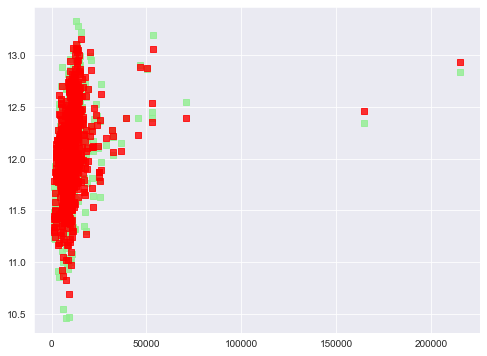

In [26]:
plt.figure(figsize=(8,6))
plt.scatter(X_train['LotArea'],y_train,c = "lightgreen", marker = "s", label = "Validation data",alpha=0.8);
plt.scatter(X_train['LotArea'],y_train_pred,c = "red", marker = "s", label = "Validation data",alpha=0.8);



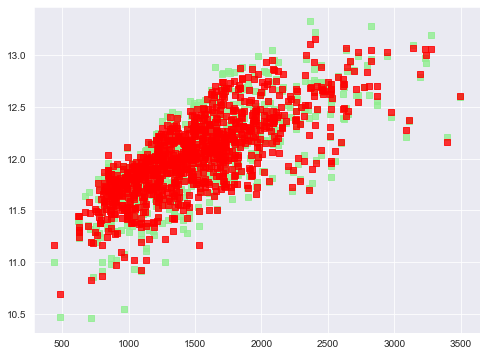

In [27]:
plt.figure(figsize=(8,6))
plt.scatter(X_train['GrLivArea'],y_train,c = "lightgreen", marker = "s", label = "Validation data",alpha=0.8);
plt.scatter(X_train['GrLivArea'],y_train_pred,c = "red", marker = "s", label = "Validation data",alpha=0.8);

In [28]:
from sklearn.model_selection import RepeatedKFold
from sklearn.preprocessing import RobustScaler
from sklearn.linear_model import LassoCV,Lasso
alphas=np.linspace(0,0.02,200)
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=50)
lassopipe=make_pipeline(RobustScaler(),LassoCV(alphas=alphas,cv=cv))

In [29]:
lassopipe.fit(X_train,y_train)

Pipeline(steps=[('robustscaler', RobustScaler()),
                ('lassocv',
                 LassoCV(alphas=array([0.        , 0.0001005 , 0.00020101, 0.00030151, 0.00040201,
       0.00050251, 0.00060302, 0.00070352, 0.00080402, 0.00090452,
       0.00100503, 0.00110553, 0.00120603, 0.00130653, 0.00140704,
       0.00150754, 0.00160804, 0.00170854, 0.00180905, 0.00190955,
       0.00201005, 0.00211055, 0.00221106, 0.00231156, 0.00241206,
       0.0...
       0.01708543, 0.01718593, 0.01728643, 0.01738693, 0.01748744,
       0.01758794, 0.01768844, 0.01778894, 0.01788945, 0.01798995,
       0.01809045, 0.01819095, 0.01829146, 0.01839196, 0.01849246,
       0.01859296, 0.01869347, 0.01879397, 0.01889447, 0.01899497,
       0.01909548, 0.01919598, 0.01929648, 0.01939698, 0.01949749,
       0.01959799, 0.01969849, 0.01979899, 0.0198995 , 0.02      ]),
                         cv=RepeatedKFold(n_repeats=3, n_splits=10, random_state=50)))])

In [30]:
y_train_pred=lassopipe.predict(X_train)
y_test_pred=lassopipe.predict(X_test)
r2_score(y_test,y_test_pred)

0.9209460976136885

Ridge picked 82 features and eliminated the other 140 features


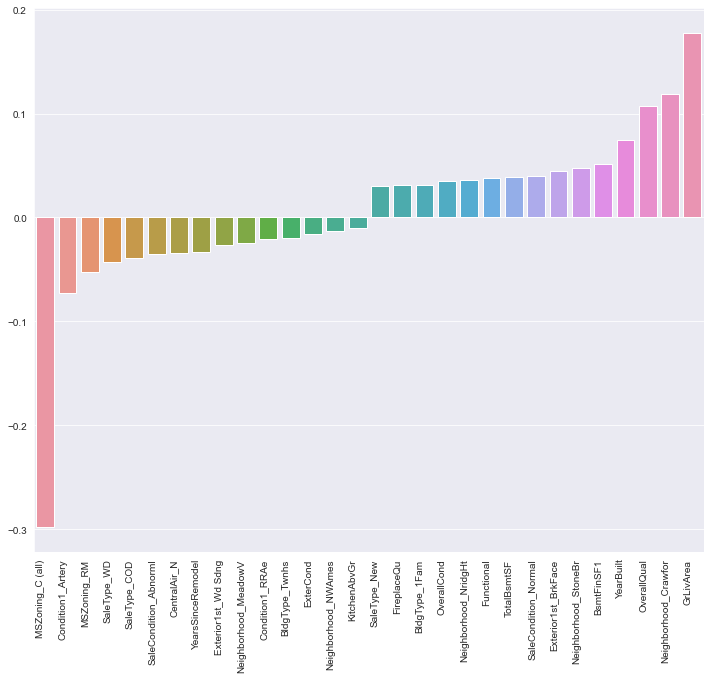

In [31]:
coefs = pd.Series(lassopipe.named_steps['lassocv'].coef_, index = X_train.columns)
print("Ridge picked " + str(sum(coefs != 0)) + " features and eliminated the other " +  \
      str(sum(coefs == 0)) + " features")
imp_coefs = pd.concat([coefs.sort_values().head(15),
                     coefs.sort_values().tail(15)])
# imp_coefs.plot(kind = "barh");
# plt.title("Coefficients in the Ridge Model")
# plt.yticks(rotation=0)

# plt.figure(figsize=(25,20))
# plt.show()
plt.figure(figsize=(12,10))

bar=sns.barplot(imp_coefs.index,imp_coefs.values)
bar.set_xticklabels(bar.get_xticklabels(), 
                          rotation=90, 
                          horizontalalignment='right')
plt.show()

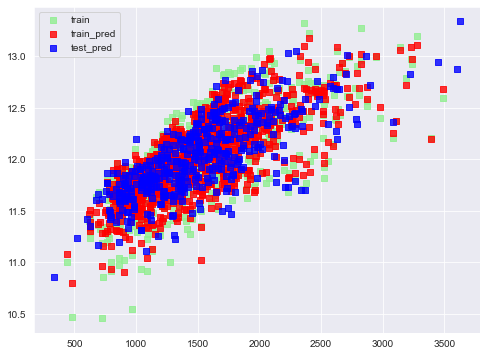

In [32]:
plt.figure(figsize=(8,6))
plt.scatter(X_train['GrLivArea'],y_train,c = "lightgreen", marker = "s", label = "train",alpha=0.8);
plt.scatter(X_train['GrLivArea'],y_train_pred,c = "red", marker = "s", label = "train_pred",alpha=0.8);
plt.scatter(X_test['GrLivArea'],y_test_pred,c = "blue", marker = "s", label = "test_pred",alpha=0.8);
plt.legend()
plt.show()

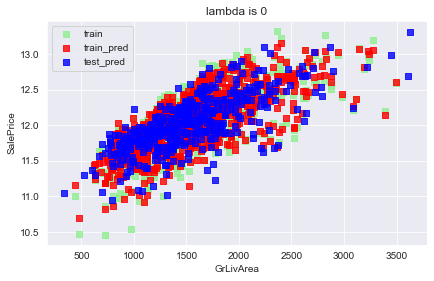

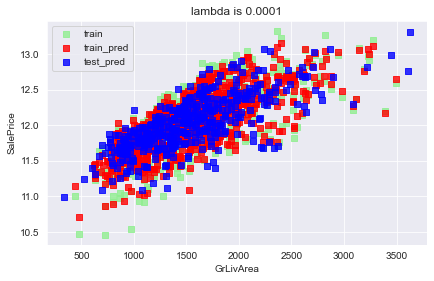

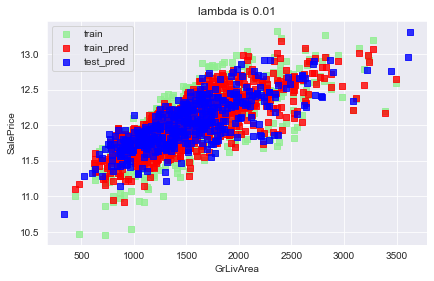

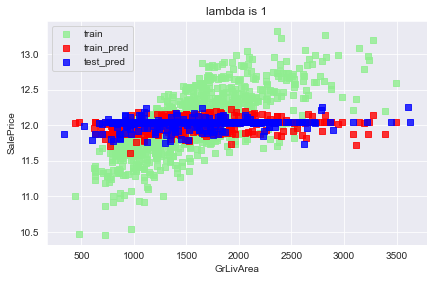

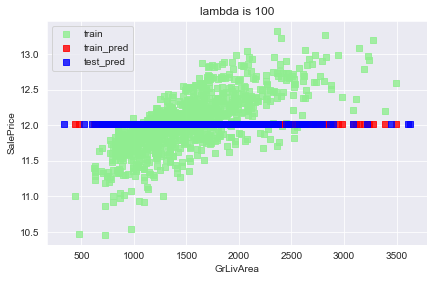

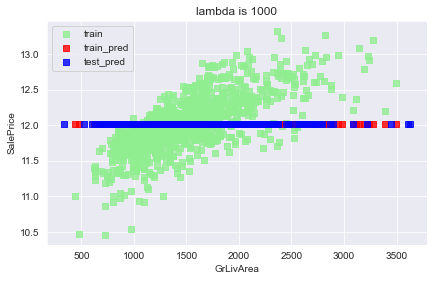

In [33]:

alphas=[0,0.0001,0.01,1,100,1000]
for i,j in enumerate(alphas):
     
    cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=50)
    lassopipe=make_pipeline(RobustScaler(),Lasso(alpha=j))
    lassopipe.fit(X_train,y_train)
    y_train_pred=lassopipe.predict(X_train)
    y_test_pred=lassopipe.predict(X_test)
    
    plt.figure(figsize=(15,14))
    plt.subplot(3,2,i+1)
    plt.xlabel('GrLivArea')
    plt.ylabel('SalePrice')
    plt.title('lambda is {}'.format(j))
    plt.scatter(X_train['GrLivArea'],y_train,c = "lightgreen", marker = "s", label = "train",alpha=0.8)
    plt.scatter(X_train['GrLivArea'],y_train_pred,c = "red", marker = "s", label = "train_pred",alpha=0.8)
    plt.scatter(X_test['GrLivArea'],y_test_pred,c = "blue", marker = "s", label = "test_pred",alpha=0.8)
    plt.legend()
    plt.show()

In [34]:
coefs.sort_values(ascending=False)

GrLivArea                1.779143e-01
Neighborhood_Crawfor     1.189699e-01
OverallQual              1.077615e-01
YearBuilt                7.449019e-02
BsmtFinSF1               5.173255e-02
Neighborhood_StoneBr     4.762441e-02
Exterior1st_BrkFace      4.522269e-02
SaleCondition_Normal     3.948841e-02
TotalBsmtSF              3.865979e-02
Functional               3.756589e-02
Neighborhood_NridgHt     3.604499e-02
OverallCond              3.542505e-02
BldgType_1Fam            3.151053e-02
FireplaceQu              3.134943e-02
SaleType_New             3.049128e-02
Neighborhood_BrkSide     3.043415e-02
Foundation_PConc         2.870802e-02
LotConfig_CulDSac        2.769434e-02
Neighborhood_ClearCr     2.743380e-02
MasVnrType_Stone         2.665054e-02
GarageQual               2.280175e-02
GarageCars               2.207435e-02
Condition1_Norm          2.188810e-02
BsmtFullBath             2.182480e-02
MSZoning_FV              2.054112e-02
HeatingQC                1.995493e-02
KitchenQual 

In [35]:
alphas=[0,0.0001,0.001,0.01,0.1,1,5,10,100]

In [36]:
from sklearn.preprocessing import PolynomialFeatures
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=50)
lassopipe=make_pipeline(RobustScaler(),PolynomialFeatures(),Lasso(alpha=0.0005))

In [37]:
num_df.head(5)

,MSSubClass,LotFrontage,LotArea,Street,Alley,LotShape,LandSlope,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscVal,MoSold,YrSold,YearsSinceRemodel,YrBltAndRemod
0,6,65.0,8450,2,0,4,3,7,5,2003,2003,196.0,4,3,4,3,0,6,706,1,0,150,856,5,856,854,0,1710,1,0,2,1,3,1,4,8,8,0,0,2003.0,2,2,548,3,3,2,0,61,0,0,0,0,0,0,0,2,2008,5,0
1,1,80.0,9600,2,0,4,3,6,8,1976,1976,0.0,3,3,4,3,3,5,978,1,0,284,1262,5,1262,0,0,1262,0,1,2,0,3,1,3,6,8,1,3,1976.0,2,2,460,3,3,2,298,0,0,0,0,0,0,0,0,5,2007,31,0
2,6,68.0,11250,2,0,3,3,7,5,2001,2002,162.0,4,3,4,3,1,6,486,1,0,434,920,5,920,866,0,1786,1,0,2,1,3,1,4,6,8,1,3,2001.0,2,2,608,3,3,2,0,42,0,0,0,0,0,0,0,9,2008,6,1
3,7,60.0,9550,2,0,3,3,7,5,1915,1970,0.0,3,3,3,4,0,5,216,1,0,540,756,4,961,756,0,1717,1,0,1,0,3,1,4,7,8,1,4,1998.0,1,3,642,3,3,2,0,35,272,0,0,0,0,0,0,2,2006,36,55
4,6,84.0,14260,2,0,3,3,8,5,2000,2000,350.0,4,3,4,3,2,6,655,1,0,490,1145,5,1145,1053,0,2198,1,0,2,1,4,1,4,9,8,1,3,2000.0,2,3,836,3,3,2,192,84,0,0,0,0,0,0,0,12,2008,8,0


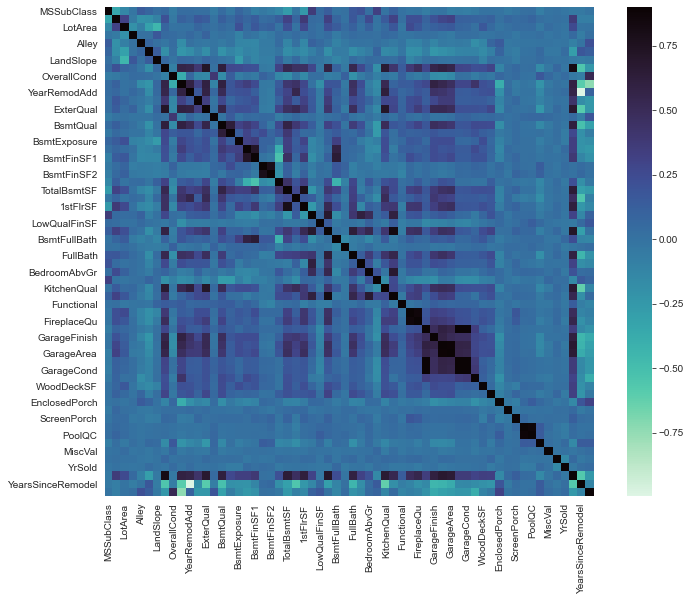

In [38]:
#correlation matrix
corrmat = data.corr()
f, ax = plt.subplots(figsize=(12, 9))
heatm = sns.heatmap(corrmat, vmax=0.9, square=True, cmap = 'mako_r');


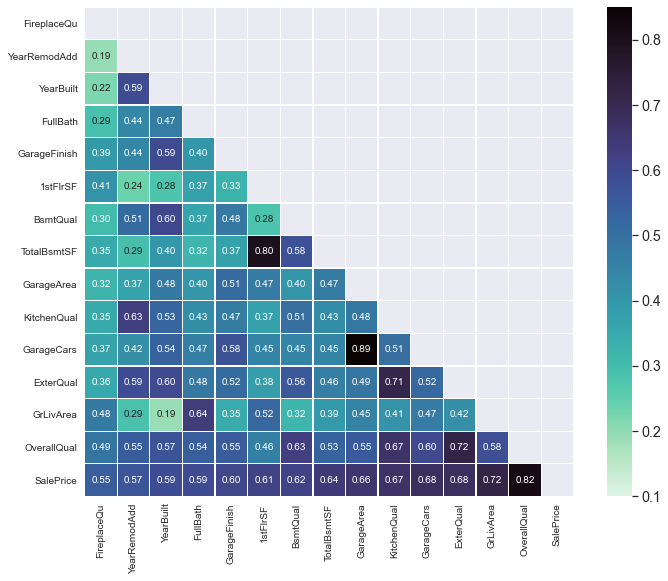

In [39]:
#saleprice correlation matrix
n = 15
#number of parameters for heatmap
cols = corrmat.nlargest(n, 'SalePrice')['SalePrice'].index
cols2 = np.array(list(reversed(cols)))
cm = data[cols2].corr()
# mask to get only the upper triangle of the matrix, as the lower one is just repeated information
mask = np.triu(np.ones_like(cm, dtype=np.bool))
# adjust mask and df

cm2 = cm.iloc[1:,:-1].copy()
f, ax = plt.subplots(figsize=(12, 9))
sns.set(font_scale=1.3)
heatmap = sns.heatmap(cm,mask=mask, cbar=True, annot=True, square=True, cmap = 'mako_r', fmt='.2f', vmin=.1, vmax=.85,linewidth=0.3, annot_kws={'size': 10}, yticklabels=cols2, xticklabels=cols2)


In [40]:
num_df.head(5)

,MSSubClass,LotFrontage,LotArea,Street,Alley,LotShape,LandSlope,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscVal,MoSold,YrSold,YearsSinceRemodel,YrBltAndRemod
0,6,65.0,8450,2,0,4,3,7,5,2003,2003,196.0,4,3,4,3,0,6,706,1,0,150,856,5,856,854,0,1710,1,0,2,1,3,1,4,8,8,0,0,2003.0,2,2,548,3,3,2,0,61,0,0,0,0,0,0,0,2,2008,5,0
1,1,80.0,9600,2,0,4,3,6,8,1976,1976,0.0,3,3,4,3,3,5,978,1,0,284,1262,5,1262,0,0,1262,0,1,2,0,3,1,3,6,8,1,3,1976.0,2,2,460,3,3,2,298,0,0,0,0,0,0,0,0,5,2007,31,0
2,6,68.0,11250,2,0,3,3,7,5,2001,2002,162.0,4,3,4,3,1,6,486,1,0,434,920,5,920,866,0,1786,1,0,2,1,3,1,4,6,8,1,3,2001.0,2,2,608,3,3,2,0,42,0,0,0,0,0,0,0,9,2008,6,1
3,7,60.0,9550,2,0,3,3,7,5,1915,1970,0.0,3,3,3,4,0,5,216,1,0,540,756,4,961,756,0,1717,1,0,1,0,3,1,4,7,8,1,4,1998.0,1,3,642,3,3,2,0,35,272,0,0,0,0,0,0,2,2006,36,55
4,6,84.0,14260,2,0,3,3,8,5,2000,2000,350.0,4,3,4,3,2,6,655,1,0,490,1145,5,1145,1053,0,2198,1,0,2,1,4,1,4,9,8,1,3,2000.0,2,3,836,3,3,2,192,84,0,0,0,0,0,0,0,12,2008,8,0


In [41]:
cat_df.head(5)

,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,Heating_Floor,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,GarageType_2Types,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,MiscFeature_Gar2,MiscFeature_None,MiscFeature_Othr,MiscFeature_Shed,MiscFeature_TenC,SaleType_COD,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
1,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
2,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
3,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,

In [42]:
polycols=[cols for cols in cols2 if cols !='SalePrice']

In [43]:
poly=PolynomialFeatures(degree=4)

In [44]:
higher=poly.fit_transform(num_df[polycols])

In [45]:
names=poly.get_feature_names(polycols)

In [46]:
high=pd.DataFrame(higher,columns=names)

In [47]:
high.head(5)

1  FireplaceQu  YearRemodAdd  YearBuilt  FullBath  GarageFinish  \
0  1.0          0.0        2003.0     2003.0       2.0           2.0   
1  1.0          3.0        1976.0     1976.0       2.0           2.0   
2  1.0          3.0        2002.0     2001.0       2.0           2.0   
3  1.0          4.0        1970.0     1915.0       1.0           1.0   
4  1.0          3.0        2000.0     2000.0       2.0           2.0   

   1stFlrSF  BsmtQual  TotalBsmtSF  GarageArea  KitchenQual  GarageCars  \
0     856.0       4.0        856.0       548.0          4.0         2.0   
1    1262.0       4.0       1262.0       460.0          3.0         2.0   
2     920.0       4.0        920.0       608.0          4.0         2.0   
3     961.0       3.0        756.0       642.0          4.0         3.0   
4    1145.0       4.0       1145.0       836.0          4.0         3.0   

   ExterQual  GrLivArea  OverallQual  FireplaceQu^2  FireplaceQu YearRemodAdd  \
0        4.0     1710.0          7.0            0.0                       0.0   
1        3.0     1262.0          6.0            9.0                    5928.0   
2        4.0     1786.0          7.0            9.0                    6006.0   
3        3.0     1717.0          7.0           16.0                    7880.0   
4        4.0     2198.0          8.0            9.0                    6000.0   

   FireplaceQu YearBuilt  FireplaceQu FullBath  FireplaceQu GarageFinish  \
0                    0.0                   0.0                       0.0   
1                 5928.0                   6.0                       6.0   
2                 6003.0                   6.0                       6.0   
3                 7660.0                   4.0                       4.0   
4                 6000.0                   6.0                       6.0   

   FireplaceQu 1stFlrSF  FireplaceQu BsmtQual  FireplaceQu TotalBsmtSF  \
0                   0.0                   0.0                      0.0   
1                3786.0                  12.0                   3786.0   
2                2760.0                  12.0                   2760.0   
3                3844.0                  12.0                   3024.0   
4                3435.0                  12.0                   3435.0   

   FireplaceQu GarageArea  FireplaceQu KitchenQual  FireplaceQu GarageCars  \
0                     0.0                      0.0                     0.0   
1                  1380.0                      9.0                     6.0   
2                  1824.0                     12.0                     6.0   
3                  2568.0                     16.0                    12.0   
4                  2508.0                     12.0                     9.0   

   FireplaceQu ExterQual  FireplaceQu GrLivArea  FireplaceQu OverallQual  \
0                    0.0                    0.0                      0.0   
1                    9.0                 3786.0                     18.0   
2                   12.0                 5358.0                     21.0   
3                   12.0                 6868.0                     28.0   
4                   12.0                 6594.0                     24.0   

   YearRemodAdd^2  YearRemodAdd YearBuilt  YearRemodAdd FullBath  \
0       4012009.0               4012009.0                 4006.0   
1       3904576.0               3904576.0                 3952.0   
2       4008004.0               4006002.0                 4004.0   
3       3880900.0               3772550.0                 1970.0   
4       4000000.0               4000000.0                 4000.0   

   YearRemodAdd GarageFinish  YearRemodAdd 1stFlrSF  YearRemodAdd BsmtQual  \
0                     4006.0              1714568.0                 8012.0   
1                     3952.0              2493712.0                 7904.0   
2                     4004.0              1841840.0                 8008.0   
3                     1970.0              1893170.0                 5910.0   
4      

In [48]:
num_df.shape

(1456, 59)

In [49]:
high.reset_index(drop=True, inplace=True)
num_df.reset_index(drop=True, inplace=True)

In [50]:
new_num_df=pd.concat([num_df,high],axis=1)

In [51]:
new_num_df.head(5)

MSSubClass  LotFrontage  LotArea  Street  Alley  LotShape  LandSlope  \
0           6         65.0     8450       2      0         4          3   
1           1         80.0     9600       2      0         4          3   
2           6         68.0    11250       2      0         3          3   
3           7         60.0     9550       2      0         3          3   
4           6         84.0    14260       2      0         3          3   

   OverallQual  OverallCond  YearBuilt  YearRemodAdd  MasVnrArea  ExterQual  \
0            7            5       2003          2003       196.0          4   
1            6            8       1976          1976         0.0          3   
2            7            5       2001          2002       162.0          4   
3            7            5       1915          1970         0.0          3   
4            8            5       2000          2000       350.0          4   

   ExterCond  BsmtQual  BsmtCond  BsmtExposure  BsmtFinType1  BsmtFinSF1  \
0          3         4         3             0             6         706   
1          3         4         3             3             5         978   
2          3         4         3             1             6         486   
3          3         3         4             0             5         216   
4          3         4         3             2             6         655   

   BsmtFinType2  BsmtFinSF2  BsmtUnfSF  TotalBsmtSF  HeatingQC  1stFlrSF  \
0             1           0        150          856          5       856   
1             1           0        284         1262          5      1262   
2             1           0        434          920          5       920   
3             1           0        540          756          4       961   
4             1           0        490         1145          5      1145   

   2ndFlrSF  LowQualFinSF  GrLivArea  BsmtFullBath  BsmtHalfBath  FullBath  \
0       854             0       1710             1             0         2   
1         0             0       1262             0             1         2   
2       866             0       1786             1             0         2   
3       756             0       1717             1             0         1   
4      1053             0       2198             1             0         2   

   HalfBath  BedroomAbvGr  KitchenAbvGr  KitchenQual  TotRmsAbvGrd  \
0         1             3             1            4             8   
1         0             3             1            3             6   
2         1             3             1            4             6   
3         0             3             1            4             7   
4         1             4             1            4             9   

   Functional  Fireplaces  FireplaceQu  GarageYrBlt  GarageFinish  GarageCars  \
0           8           0            0       2003.0             2           2   
1           8           1            3       1976.0             2           2   
2           8           1            3       2001.0             2           2   
3           8           1            4       1998.0             1           3   
4           8           1            3       2000.0             2           3   

   GarageArea  GarageQual  GarageCond  PavedDrive  WoodDeckSF  OpenPorchSF  \
0         548           3           3           2           0           61   
1         460           3           3           2         298            0   
2         608           3           3           2           0           42   
3         642           3           3           2           0           35   
4         836           3           3           2         192           84   

   EnclosedPorch  3SsnPorch  ScreenPorch  PoolArea  PoolQC  Fence  MiscVal  \
0              0          0            0         0       0      0        0   
1              0          0            0         0       0      0        0   
2              0          0            0         0       0      0        0   
3    

In [52]:
new_num_df.shape

(1456, 3119)

In [53]:
final_col_names=new_num_df.columns

In [54]:
from scipy.stats import skew, norm
from scipy.special import boxcox1p
from scipy.stats import boxcox_normmax


In [55]:
# Find skewed numerical features
skewed_feats = new_num_df.apply(lambda x: skew(x.dropna())).sort_values(ascending=False)
print("\nSkew in numerical features: \n")
skewness = pd.DataFrame({'Skew' :skewed_feats})
skewness.head(15)


Skew in numerical features: 



,Skew
MiscVal,24.418175
PoolQC,21.128703
PoolArea,17.504556
LotArea,12.574590
TotalBsmtSF^4,10.636513
3SsnPorch,10.279262
LowQualFinSF,8.989291
1stFlrSF TotalBsmtSF^3,8.957700
1stFlrSF^2 TotalBsmtSF^2,8.682832
1stFlrSF^3 TotalBsmtSF,8.394388


In [56]:
skewness = skewness[abs(skewness) > 0.75]
print("There are {} skewed numerical features to Box Cox transform".format(skewness.shape[0]))

from scipy.special import boxcox1p
skewed_features = skewness.index
lam = 0.15
for feat in skewed_features:
    #all_data[feat] += 1
    new_num_df[feat] = boxcox1p(new_num_df[feat], lam)
    

There are 3119 skewed numerical features to Box Cox transform


In [57]:
new_num_df.head(5)

MSSubClass  LotFrontage    LotArea    Street  Alley  LotShape  LandSlope  \
0    2.259674     5.831328  19.212182  1.194318    0.0  1.820334   1.540963   
1    0.730463     6.221214  19.712205  1.194318    0.0  1.820334   1.540963   
2    2.259674     5.914940  20.347241  1.194318    0.0  1.540963   1.540963   
3    2.440268     5.684507  19.691553  1.194318    0.0  1.540963   1.540963   
4    2.259674     6.314735  21.325160  1.194318    0.0  1.540963   1.540963   

   OverallQual  OverallCond  YearBuilt  YearRemodAdd  MasVnrArea  ExterQual  \
0     1.357457     2.055642   3.359428      3.359428    8.059126   1.121833   
1     1.292816     2.602594   3.355226      3.355226    0.000000   1.000916   
2     1.357457     2.055642   3.359119      3.359273    7.646538   1.121833   
3     1.357457     2.055642   3.345510      3.354284    0.000000   1.000916   
4     1.413141     2.055642   3.358964      3.358964    9.391827   1.121833   

   ExterCond  BsmtQual  BsmtCond  BsmtExposure  BsmtFinType1  BsmtFinSF1  \
0   1.540963  1.121833  1.540963      0.000000      2.259674   11.170327   
1   1.540963  1.121833  1.540963      1.540963      2.055642   12.062832   
2   1.540963  1.121833  1.540963      0.730463      2.259674   10.200343   
3   1.540963  1.000916  1.820334      0.000000      2.055642    8.274266   
4   1.540963  1.121833  1.540963      1.194318      2.259674   10.971129   

   BsmtFinType2  BsmtFinSF2  BsmtUnfSF  TotalBsmtSF  HeatingQC  1stFlrSF  \
0      0.730463         0.0   7.483296     3.093145   2.055642  3.093145   
1      0.730463         0.0   8.897844     3.215545   2.055642  3.215545   
2      0.730463         0.0   9.917060     3.115994   2.055642  3.115994   
3      0.730463         0.0  10.468500     3.053649   1.820334  3.129784   
4      0.730463         0.0  10.221051     3.185004   2.055642  3.185004   

    2ndFlrSF  LowQualFinSF  GrLivArea  BsmtFullBath  BsmtHalfBath  FullBath  \
0  11.686189           0.0   3.310366      0.730463      0.000000  0.834066   
1   0.000000           0.0   3.215545      0.000000      0.730463  0.834066   
2  11.724598           0.0   3.323876      0.730463      0.000000  0.834066   
3  11.354094           0.0   3.311636      0.730463      0.000000  0.571575   
4  12.271365           0.0   3.388158      0.730463      0.000000  0.834066   

   HalfBath  BedroomAbvGr  KitchenAbvGr  KitchenQual  TotRmsAbvGrd  \
0  0.730463      1.540963      0.730463     1.121833      2.602594   
1  0.000000      1.540963      0.730463     1.000916      2.259674   
2  0.730463      1.540963      0.730463     1.121833      2.259674   
3  0.000000      1.540963      0.730463     1.121833      2.440268   
4  0.730463      1.820334      0.730463     1.121833      2.750250   

   Functional  Fireplaces  FireplaceQu  GarageYrBlt  GarageFinish  GarageCars  \
0    2.602594    0.000000     0.000000    14.187527      0.834066    0.834066   
1    2.602594    0.730463     1.000916    14.145138      0.834066    0.834066   
2    2.602594    0.730463     1.000916    14.184404      0.834066    0.834066   
3    2.602594    0.730463     1.121833    14.179714      0.571575    1.000916   
4    2.602594    0.730463     1.000916    14.182841      0.834066    1.000916   

   GarageArea  GarageQual  GarageCond  PavedDrive  WoodDeckSF  OpenPorchSF  \
0    2.950540    1.540963    1.540963    1.194318    0.000000     5.714669   
1    2.893916    1.540963    1.540963    1.194318    9.010206     0.000000   
2    2.983967    1.540963    1.540963    1.194318    0.000000     5.053371   
3    3.001422    1.540963    1.540963    1.194318    0.000000     4.745132   
4    3.085642    1.540963    1.540963    1.194318    8.013884     6.314735   

   EnclosedPorch  3SsnPorch  ScreenPorch  PoolArea  PoolQC  Fence  MiscVal  \
0       0.000000        0.0          0.0       0.0     0.0    0.0      0.0   
1       0.000000        0.0          0.0       0.0     0.0    0.0      0.0   
2       0.000000        0.0          0.0       0.0   

In [58]:
robust=RobustScaler()

In [59]:
new_num_df=robust.fit_transform(new_num_df)

In [60]:
new_num_df=pd.DataFrame(new_num_df,columns=final_col_names)

In [61]:
new_num_df.head(5)

MSSubClass  LotFrontage   LotArea  Street  Alley  LotShape  LandSlope  \
0    0.119331    -0.256476 -0.262931     0.0    0.0       0.0        0.0   
1   -0.775046     0.469964  0.032173     0.0    0.0       0.0        0.0   
2    0.119331    -0.100689  0.406959     0.0    0.0      -1.0        0.0   
3    0.224954    -0.530036  0.019984     0.0    0.0      -1.0        0.0   
4    0.119331     0.644214  0.984108     0.0    0.0      -1.0        0.0   

   OverallQual  OverallCond  YearBuilt  YearRemodAdd  MasVnrArea  ExterQual  \
0     0.457016     0.000000   0.670248      0.253344    1.051701        1.0   
1     0.000000     2.680718   0.087088     -0.469937    0.000000        0.0   
2     0.457016     0.000000   0.627328      0.226735    0.997859        1.0   
3     0.457016     0.000000  -1.261058     -0.632041    0.000000        0.0   
4     0.850718     0.000000   0.605851      0.173475    1.225616        1.0   

   ExterCond  BsmtQual  BsmtCond  BsmtExposure  BsmtFinType1  BsmtFinSF1  \
0        0.0       0.0  0.000000      0.000000      0.287298    0.140826   
1        0.0       0.0  0.000000      2.109569      0.153875    0.220712   
2        0.0       0.0  0.000000      1.000000      0.287298    0.054005   
3        0.0      -1.0  0.279371      0.000000      0.153875   -0.118394   
4        0.0       0.0  0.000000      1.635014      0.287298    0.122996   

   BsmtFinType2  BsmtFinSF2  BsmtUnfSF  TotalBsmtSF  HeatingQC  1stFlrSF  \
0           0.0         0.0  -0.836731    -0.300589   0.000000 -0.526043   
1           0.0         0.0  -0.393859     0.495925   0.000000  0.330005   
2           0.0         0.0  -0.074759    -0.151901   0.000000 -0.366242   
3           0.0         0.0   0.097888    -0.557609  -0.457193 -0.269792   
4           0.0         0.0   0.020416     0.297181   0.000000  0.116406   

   2ndFlrSF  LowQualFinSF  GrLivArea  BsmtFullBath  BsmtHalfBath  FullBath  \
0  1.038541           0.0   0.349717           1.0      0.000000       0.0   
1  0.000000           0.0  -0.319453           0.0      0.730463       0.0   
2  1.041955           0.0   0.445055           1.0      0.000000       0.0   
3  1.009028           0.0   0.358678           1.0      0.000000      -1.0   
4  1.090545           0.0   0.898703           1.0      0.000000       0.0   

   HalfBath  BedroomAbvGr  KitchenAbvGr  KitchenQual  TotRmsAbvGrd  \
0       1.0      0.000000           0.0          1.0      0.891567   
1       0.0      0.000000           0.0          0.0      0.000000   
2       1.0      0.000000           0.0          1.0      0.000000   
3       0.0      0.000000           0.0          1.0      0.469532   
4       1.0      0.805929           0.0          1.0      1.275461   

   Functional  Fireplaces  FireplaceQu  GarageYrBlt  GarageFinish  GarageCars  \
0         0.0        -1.0    -0.743484     0.601928           0.0    0.000000   
1         0.0         0.0     0.148730    -0.023285           0.0    0.000000   
2         0.0         0.0     0.148730     0.555862           0.0    0.000000   
3         0.0         0.0     0.256516     0.486690          -1.0    0.635645   
4         0.0         0.0     0.148730     0.532815           0.0    0.635645   

   GarageArea  GarageQual  GarageCond  PavedDrive  WoodDeckSF  OpenPorchSF  \
0    0.241197         0.0         0.0         0.0    0.000000     0.266606   
1   -0.070368         0.0         0.0         0.0    1.166466    -0.699536   
2    0.425130         0.0         0.0         0.0    0.000000     0.154805   
3    0.521174         0.0         0.0         0.0    0.000000     0.102693   
4    0.984584         0.0         0.0         0.0    1.037482     0.368055   

   EnclosedPorch  3SsnPorch  ScreenPorch  PoolArea  PoolQC  Fence  MiscVal  \
0       0.000000        0.0          0.0       0.0     0.0    0.0      0.0   
1       0.000000        0.0          0.0       0.0     0.0    0.0      0.0   
2       0.000000        0.0          0.0       0.0     0.0    0.0      0.0   

In [62]:
new_num_df.reset_index(drop=True, inplace=True)

In [63]:
cat_df=pd.get_dummies(cat_df)

In [64]:
cat_df.reset_index(drop=True, inplace=True)

In [65]:
full_df=pd.concat([new_num_df,cat_df],axis=1)

In [66]:
full_df.shape

(1456, 3282)

In [67]:
full_df.head(5)

MSSubClass  LotFrontage   LotArea  Street  Alley  LotShape  LandSlope  \
0    0.119331    -0.256476 -0.262931     0.0    0.0       0.0        0.0   
1   -0.775046     0.469964  0.032173     0.0    0.0       0.0        0.0   
2    0.119331    -0.100689  0.406959     0.0    0.0      -1.0        0.0   
3    0.224954    -0.530036  0.019984     0.0    0.0      -1.0        0.0   
4    0.119331     0.644214  0.984108     0.0    0.0      -1.0        0.0   

   OverallQual  OverallCond  YearBuilt  YearRemodAdd  MasVnrArea  ExterQual  \
0     0.457016     0.000000   0.670248      0.253344    1.051701        1.0   
1     0.000000     2.680718   0.087088     -0.469937    0.000000        0.0   
2     0.457016     0.000000   0.627328      0.226735    0.997859        1.0   
3     0.457016     0.000000  -1.261058     -0.632041    0.000000        0.0   
4     0.850718     0.000000   0.605851      0.173475    1.225616        1.0   

   ExterCond  BsmtQual  BsmtCond  BsmtExposure  BsmtFinType1  BsmtFinSF1  \
0        0.0       0.0  0.000000      0.000000      0.287298    0.140826   
1        0.0       0.0  0.000000      2.109569      0.153875    0.220712   
2        0.0       0.0  0.000000      1.000000      0.287298    0.054005   
3        0.0      -1.0  0.279371      0.000000      0.153875   -0.118394   
4        0.0       0.0  0.000000      1.635014      0.287298    0.122996   

   BsmtFinType2  BsmtFinSF2  BsmtUnfSF  TotalBsmtSF  HeatingQC  1stFlrSF  \
0           0.0         0.0  -0.836731    -0.300589   0.000000 -0.526043   
1           0.0         0.0  -0.393859     0.495925   0.000000  0.330005   
2           0.0         0.0  -0.074759    -0.151901   0.000000 -0.366242   
3           0.0         0.0   0.097888    -0.557609  -0.457193 -0.269792   
4           0.0         0.0   0.020416     0.297181   0.000000  0.116406   

   2ndFlrSF  LowQualFinSF  GrLivArea  BsmtFullBath  BsmtHalfBath  FullBath  \
0  1.038541           0.0   0.349717           1.0      0.000000       0.0   
1  0.000000           0.0  -0.319453           0.0      0.730463       0.0   
2  1.041955           0.0   0.445055           1.0      0.000000       0.0   
3  1.009028           0.0   0.358678           1.0      0.000000      -1.0   
4  1.090545           0.0   0.898703           1.0      0.000000       0.0   

   HalfBath  BedroomAbvGr  KitchenAbvGr  KitchenQual  TotRmsAbvGrd  \
0       1.0      0.000000           0.0          1.0      0.891567   
1       0.0      0.000000           0.0          0.0      0.000000   
2       1.0      0.000000           0.0          1.0      0.000000   
3       0.0      0.000000           0.0          1.0      0.469532   
4       1.0      0.805929           0.0          1.0      1.275461   

   Functional  Fireplaces  FireplaceQu  GarageYrBlt  GarageFinish  GarageCars  \
0         0.0        -1.0    -0.743484     0.601928           0.0    0.000000   
1         0.0         0.0     0.148730    -0.023285           0.0    0.000000   
2         0.0         0.0     0.148730     0.555862           0.0    0.000000   
3         0.0         0.0     0.256516     0.486690          -1.0    0.635645   
4         0.0         0.0     0.148730     0.532815           0.0    0.635645   

   GarageArea  GarageQual  GarageCond  PavedDrive  WoodDeckSF  OpenPorchSF  \
0    0.241197         0.0         0.0         0.0    0.000000     0.266606   
1   -0.070368         0.0         0.0         0.0    1.166466    -0.699536   
2    0.425130         0.0         0.0         0.0    0.000000     0.154805   
3    0.521174         0.0         0.0         0.0    0.000000     0.102693   
4    0.984584         0.0         0.0         0.0    1.037482     0.368055   

   EnclosedPorch  3SsnPorch  ScreenPorch  PoolArea  PoolQC  Fence  MiscVal  \
0       0.000000        0.0          0.0       0.0     0.0    0.0      0.0   
1       0.000000        0.0          0.0       0.0     0.0    0.0      0.0   
2       0.000000        0.0          0.0       0.0     0.0    0.0      0.0   

In [68]:
full_df.shape

(1456, 3282)

In [69]:
y.shape

(1456,)

In [70]:
full_df = full_df.loc[:,~full_df.columns.duplicated()]

In [71]:
full_df.shape

(1456, 3268)

In [72]:
# visualise our final model

ValueError: num must be 1 <= num <= 120, not 121

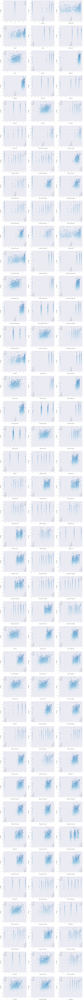

In [73]:
fig, axs = plt.subplots(figsize=(12, 150))
plt.subplots_adjust(right=2)
plt.subplots_adjust(top=2)
sns.color_palette("husl", 8)
for i, feature in enumerate(full_df[names]):
    if(feature=='MiscVal'):
        break
    plt.subplot(40, 3, i+1)
    sns.scatterplot(x=feature, y=y, hue=y, palette='Blues', data=full_df)
        
    plt.xlabel('{}'.format(feature), size=15,labelpad=12.5)
    plt.ylabel('SalePrice', size=15, labelpad=12.5)
    
    for j in range(2):
        plt.tick_params(axis='x', labelsize=12)
        plt.tick_params(axis='y', labelsize=12)
    
    plt.legend(loc='best', prop={'size': 10})
        
plt.show()




In [74]:
X_train,X_test,y_train,y_test=train_test_split(full_df,y,test_size=0.3,random_state=100)

In [75]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(1019, 3268)
(437, 3268)
(1019,)
(437,)


In [76]:
from sklearn.model_selection import KFold,cross_val_score
from sklearn.metrics import r2_score
kf = KFold(n_splits=12, random_state=42, shuffle=True)
# Define error metrics
def rmsle(y, y_pred):
    return np.sqrt(mean_squared_error(y, y_pred))

def cv_r2(model, X,y):
    r2 = cross_val_score(model, X, y, scoring="r2", cv=3,verbose=2)
    return (r2)

In [81]:
# lasso Regressor
alpha=np.linspace(0,0.02,200)
las= LassoCV(alphas=alpha, cv=2)

In [82]:
las.fit(X_train,y_train)

LassoCV(alphas=array([0.        , 0.0001005 , 0.00020101, 0.00030151, 0.00040201,
       0.00050251, 0.00060302, 0.00070352, 0.00080402, 0.00090452,
       0.00100503, 0.00110553, 0.00120603, 0.00130653, 0.00140704,
       0.00150754, 0.00160804, 0.00170854, 0.00180905, 0.00190955,
       0.00201005, 0.00211055, 0.00221106, 0.00231156, 0.00241206,
       0.00251256, 0.00261307, 0.00271357, 0.00281407, 0.00291457,
       0.00301...
       0.01658291, 0.01668342, 0.01678392, 0.01688442, 0.01698492,
       0.01708543, 0.01718593, 0.01728643, 0.01738693, 0.01748744,
       0.01758794, 0.01768844, 0.01778894, 0.01788945, 0.01798995,
       0.01809045, 0.01819095, 0.01829146, 0.01839196, 0.01849246,
       0.01859296, 0.01869347, 0.01879397, 0.01889447, 0.01899497,
       0.01909548, 0.01919598, 0.01929648, 0.01939698, 0.01949749,
       0.01959799, 0.01969849, 0.01979899, 0.0198995 , 0.02      ]),
        cv=2)

In [83]:
las.alpha_

0.0004020100502512563

In [84]:
score = cv_r2(las,X_test,y_test)
print("lasso: {:.4f} ({:.4f})".format(score.mean(), score.std()))


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV] END .................................................... total time=  11.5s


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   11.5s remaining:    0.0s


[CV] END .................................................... total time=  12.9s
[CV] END .................................................... total time=  11.1s
lasso: 0.9011 (0.0169)


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   35.7s finished


Lasso picked 146 features and eliminated the other 3122 features


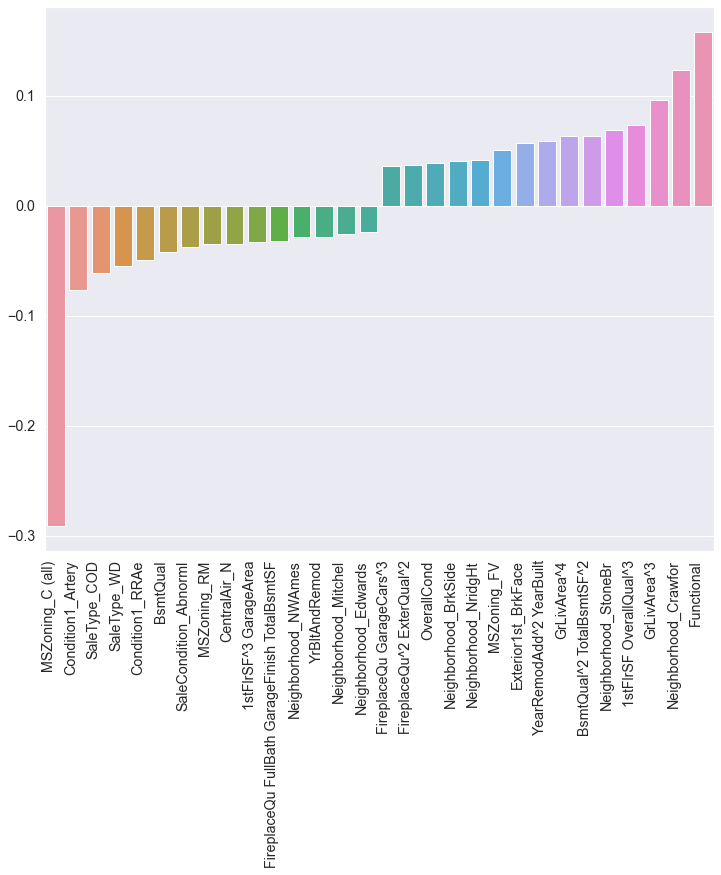

In [86]:
coefs = pd.Series(las.coef_, index = X_train.columns)
print("Lasso picked " + str(sum(coefs != 0)) + " features and eliminated the other " +  \
      str(sum(coefs == 0)) + " features")
imp_coefs = pd.concat([coefs.sort_values().head(15),
                     coefs.sort_values().tail(15)])
# imp_coefs.plot(kind = "barh");
# plt.title("Coefficients in the Ridge Model")
# plt.yticks(rotation=0)

# plt.figure(figsize=(25,20))
# plt.show()
plt.figure(figsize=(12,10))

bar=sns.barplot(imp_coefs.index,imp_coefs.values)
bar.set_xticklabels(bar.get_xticklabels(), 
                          rotation=90, 
                          horizontalalignment='right')
plt.show()

In [87]:
y_train_pred=las.predict(X_train)
print('r2 score train is {}'.format(r2_score(y_train,y_train_pred)))

r2 score train is 0.9399588372902923


In [88]:
y_test_pred=las.predict(X_test)
print('r2 score test is {}'.format(r2_score(y_test,y_test_pred)))

r2 score test is 0.9284578573895437


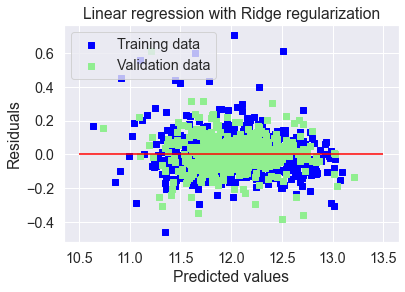

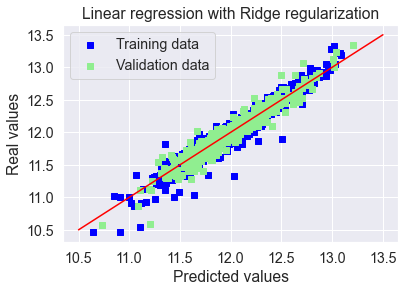

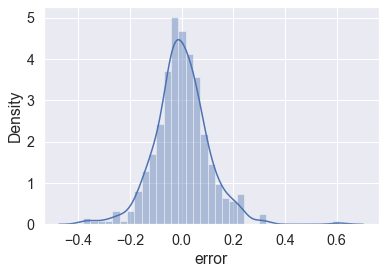

In [91]:
# Plot residuals


plt.scatter(y_train_pred, y_train_pred - y_train, c = "blue", marker = "s", label = "Training data")
plt.scatter(y_test_pred, y_test_pred - y_test, c = "lightgreen", marker = "s", label = "Validation data")
plt.title("Linear regression with Ridge regularization")
plt.xlabel("Predicted values")
plt.ylabel("Residuals")
plt.legend(loc = "upper left")
plt.hlines(y = 0, xmin = 10.5, xmax = 13.5, color = "red")
plt.show()

# Plot predictions
plt.scatter(y_train_pred, y_train, c = "blue", marker = "s", label = "Training data")
plt.scatter(y_test_pred, y_test, c = "lightgreen", marker = "s", label = "Validation data")
plt.title("Linear regression with Ridge regularization")
plt.xlabel("Predicted values")
plt.ylabel("Real values")
plt.legend(loc = "upper left")
plt.plot([10.5, 13.5], [10.5, 13.5], c = "red")
plt.show()

sns.distplot((y_test_pred - y_test),axlabel='error');

In [92]:
X_test.head()

MSSubClass  LotFrontage   LotArea  Street  Alley  LotShape  LandSlope  \
1419    0.406250    -0.283024  1.803267     0.0    0.0 -1.000000        0.0   
432     0.691357    -3.412048 -3.306231     0.0    0.0  0.000000        0.0   
1027    0.691357    -3.794380 -3.548622     0.0    0.0  0.000000        0.0   
584    -0.775046     0.811628  0.447686     0.0    0.0  0.000000        0.0   
1342   -0.775046     0.469964  1.944091     0.0    0.0 -2.240804        0.0   

      OverallQual  OverallCond  YearBuilt  YearRemodAdd  MasVnrArea  \
1419     0.000000     1.885128  -0.130972     -0.740391    0.000000   
432     -0.542984     0.000000  -0.021800     -0.604988    1.248200   
1027     0.000000     1.885128   0.000000     -0.577950    1.157931   
584      0.850718     0.000000   0.713124      0.333091    1.068822   
1342     0.457016     1.885128  -0.087269      0.253344    0.000000   

      ExterQual  ExterCond  BsmtQual  BsmtCond  BsmtExposure  BsmtFinType1  \
1419        1.0   0.279371  0.000000       0.0      1.635014     -0.712702   
432         0.0   0.000000 -1.000000       0.0      0.000000      0.153875   
1027        0.0   0.000000 -1.000000       0.0      0.000000      0.000000   
584         1.0   0.000000  0.778912       0.0      2.109569      0.287298   
1342        0.0   0.000000 -1.000000       0.0      0.000000      0.000000   

      BsmtFinSF1  BsmtFinType2  BsmtFinSF2  BsmtUnfSF  TotalBsmtSF  HeatingQC  \
1419   -0.859005        0.0000     0.00000   0.306897    -0.726318  -1.000000   
432     0.046936        0.0000     0.00000  -0.368586    -0.533078   0.000000   
1027   -0.039495        0.0000     0.00000  -0.228522    -0.802316  -0.457193   
584     0.324469        0.0000     0.00000  -0.122537     1.291542   0.000000   
1342   -0.053227        0.8105     5.91494   0.781863     0.937416  -1.000000   

      1stFlrSF  2ndFlrSF  LowQualFinSF  GrLivArea  BsmtFullBath  BsmtHalfBath  \
1419  0.814199  0.964400           0.0   0.901676           0.0      0.000000   
432  -0.775909  0.954541           0.0  -0.146095           1.0      0.000000   
1027 -1.065270  0.932848           0.0  -0.397995           0.0      0.730463   
584   1.363164  0.000000           0.0   0.723048           1.0      0.000000   
1342  1.495553  0.000000           0.0   0.856634           0.0      0.000000   

      FullBath  HalfBath  BedroomAbvGr  KitchenAbvGr  KitchenQual  \
1419       0.0       0.0      0.805929           0.0          1.0   
432       -1.0       1.0     -1.000000           0.0          0.0   
1027      -1.0       1.0      0.000000           0.0          0.0   
584        0.0       0.0     -1.000000           0.0          1.0   
1342       0.0       0.0      0.000000           0.0          0.0   

      TotRmsAbvGrd  Functional  Fireplaces  FireplaceQu  GarageYrBlt  \
1419      0.891567    0.000000    0.000000     0.256516    -0.256688   
432       0.000000   -0.162326   -1.000000    -0.743484    -0.139861   
1027      0.469532    0.000000   -1.000000    -0.743484    -0.116526   
584       0.469532    0.000000    0.635014     0.256516     0.647954   
1342      1.275461    0.000000    0.000000     0.256516    -0.209927   

      GarageFinish  GarageCars  GarageArea  GarageQual  GarageCond  \
1419          -1.0    0.000000   -0.182680    0.279371    0.279371   
432           -1.0    0.000000   -0.149835    0.000000    0.000000   
1027          -1.0   -1.000000   -1.074056    0.000000    0.000000   
584            0.0    0.635645    1.074121    0.000000    0.000000   
1342           0.0    0.000000    0.106558    0.279371    0.000000   

      PavedDrive  WoodDeckSF  OpenPorchSF  EnclosedPorch  3SsnPorch  \
1419         0.0    1.382579     0.732966            0.0   0.000000   
432          0.0    1.101867     0.110638            0.0   0.000000   
1027         0.0    0.000000     0.041122            0.0   0.000000   
584          0.0    1.193902     0.291100            0.0   0.000000   
1342         0.0    0.000000     0.35